In [146]:
#Gas-Turbines

In [147]:
#!pip install tensorflow

In [148]:
#Importing Necessary Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
plt.rcParams['figure.figsize'] = (10,5)
plt.rcParams['figure.dpi'] = 300
sns.set_theme(style='darkgrid',palette='viridis')
from pandas import read_csv
from pandas.plotting import lag_plot
from statsmodels.graphics.tsaplots import plot_acf
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense
from sklearn.metrics import classification_report
from tensorflow.keras.callbacks import EarlyStopping
import warnings
warnings.filterwarnings('ignore')


In [149]:
#Read The Dataset
df = pd.read_csv('https://raw.githubusercontent.com/KJanhavi2424/My-Datasets/main/gas_turbines.csv')
df

,AT,AP,AH,AFDP,GTEP,TIT,TAT,TEY,CDP,CO,NOX
0,6.8594,1007.9,96.799,3.5000,19.663,1059.2,550.00,114.70,10.605,3.1547,82.722
1,6.7850,1008.4,97.118,3.4998,19.728,1059.3,550.00,114.72,10.598,3.2363,82.776
2,6.8977,1008.8,95.939,3.4824,19.779,1059.4,549.87,114.71,10.601,3.2012,82.468
3,7.0569,1009.2,95.249,3.4805,19.792,1059.6,549.99,114.72,10.606,3.1923,82.670
4,7.3978,1009.7,95.150,3.4976,19.765,1059.7,549.98,114.72,10.612,3.2484,82.311
...,...,...,...,...,...,...,...,...,...,...,...
15034,9.0301,1005.6,98.460,3.5421,19.164,1049.7,546.21,111.61,10.400,4.5186,79.559
15035,7.8879,1005.9,99.093,3.5059,19.414,1046.3,543.22,111.78,10.433,4.8470,79.917
15036,7.2647,1006.3,99.496,3.4770,19.530,1037.7,537.32,110.19,10.483,7.9632,90.912
15037,7.0060,1006.8,99.008,3.4486,19.377,1043.2,541.24,110.74,10.533,6.2494,93.227


In [150]:
df.describe()

,AT,AP,AH,AFDP,GTEP,TIT,TAT,TEY,CDP,CO,NOX
count,15039.000000,15039.00000,15039.000000,15039.000000,15039.000000,15039.000000,15039.000000,15039.000000,15039.000000,15039.000000,15039.000000
mean,17.764381,1013.19924,79.124174,4.200294,25.419061,1083.798770,545.396183,134.188464,12.102353,1.972499,68.190934
std,7.574323,6.41076,13.793439,0.760197,4.173916,16.527806,7.866803,15.829717,1.103196,2.222206,10.470586
min,0.522300,985.85000,30.344000,2.087400,17.878000,1000.800000,512.450000,100.170000,9.904400,0.000388,27.765000
25%,11.408000,1008.90000,69.750000,3.723900,23.294000,1079.600000,542.170000,127.985000,11.622000,0.858055,61.303500
50%,18.186000,1012.80000,82.266000,4.186200,25.082000,1088.700000,549.890000,133.780000,12.025000,1.390200,66.601000
75%,23.862500,1016.90000,90.043500,4.550900,27.184000,1096.000000,550.060000,140.895000,12.578000,2.160400,73.935500
max,34.929000,1034.20000,100.200000,7.610600,37.402000,1100.800000,550.610000,174.610000,15.081000,44.103000,119.890000


In [151]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15039 entries, 0 to 15038
Data columns (total 11 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   AT      15039 non-null  float64
 1   AP      15039 non-null  float64
 2   AH      15039 non-null  float64
 3   AFDP    15039 non-null  float64
 4   GTEP    15039 non-null  float64
 5   TIT     15039 non-null  float64
 6   TAT     15039 non-null  float64
 7   TEY     15039 non-null  float64
 8   CDP     15039 non-null  float64
 9   CO      15039 non-null  float64
 10  NOX     15039 non-null  float64
dtypes: float64(11)
memory usage: 1.3 MB


In [152]:
#Artificial Neural Network(ANN)

In [153]:
x = df.iloc[:,:-1]
y = df.iloc[:,-1]

In [154]:
sc = StandardScaler()

In [155]:
x = sc.fit_transform(x)
x

array([[-1.4397781 , -0.82664395,  1.28143632, ..., -1.23117246,
        -1.35733078,  0.53201195],
       [-1.44960109, -0.74864748,  1.30456402, ..., -1.22990897,
        -1.36367619,  0.56873344],
       [-1.43472138, -0.68625031,  1.21908576, ..., -1.23054071,
        -1.36095673,  0.5529378 ],
       ...,
       [-1.38626659, -1.07623263,  1.47697056, ..., -1.5160891 ,
        -1.46792219,  2.69592467],
       [-1.42042259, -0.99823616,  1.44159024, ..., -1.48134317,
        -1.42259784,  1.9246834 ],
       [-1.43073409, -0.93583899,  1.33465179, ..., -1.42827666,
        -1.37727349,  1.35415028]])

In [156]:
xtrain,xtest,ytrain,ytest = train_test_split(x,y,test_size=0.2,random_state=1)

In [157]:
#Initialize the ann
ann = Sequential()

#Create the Hidden Layer
ann.add(Dense(units=10,activation='relu'))

#Create the output layer
ann.add(Dense(units=1,activation='sigmoid'))

#Establish the connection between all the layers
ann.compile(optimizer='adadelta',loss='binary_crossentropy',metrics='accuracy')

#Train ANN
ann.fit(xtrain,ytrain,epochs=50,validation_data=(xtest,ytest))

Epoch 1/50
376/376 [==============================] - 2s 3ms/step - loss: 1.5131 - accuracy: 0.0000e+00 - val_loss: 2.3264 - val_accuracy: 0.0000e+00
Epoch 2/50
376/376 [==============================] - 1s 4ms/step - loss: 0.9966 - accuracy: 0.0000e+00 - val_loss: 1.7732 - val_accuracy: 0.0000e+00
Epoch 3/50
376/376 [==============================] - 1s 3ms/step - loss: 0.4233 - accuracy: 0.0000e+00 - val_loss: 1.1697 - val_accuracy: 0.0000e+00
Epoch 4/50
376/376 [==============================] - 1s 2ms/step - loss: -0.1940 - accuracy: 0.0000e+00 - val_loss: 0.5285 - val_accuracy: 0.0000e+00
Epoch 5/50
376/376 [==============================] - 1s 2ms/step - loss: -0.8442 - accuracy: 0.0000e+00 - val_loss: -0.1418 - val_accuracy: 0.0000e+00
Epoch 6/50
376/376 [==============================] - 1s 2ms/step - loss: -1.5195 - accuracy: 0.0000e+00 - val_loss: -0.8364 - val_accuracy: 0.0000e+00
Epoch 7/50
376/376 [==============================] - 1s 3ms/step - loss: -2.2212 - accuracy: 0

In [158]:
ypred = ann.predict(xtest)
ypred

94/94 [==============================] - 0s 1ms/step


array([[0.82169706],
       [0.57746905],
       [0.75303006],
       ...,
       [0.7502257 ],
       [0.56603074],
       [0.760856  ]], dtype=float32)

In [159]:
ypred = ypred>0.5

In [160]:
ypred

array([[ True],
       [ True],
       [ True],
       ...,
       [ True],
       [ True],
       [ True]])

In [161]:
ytest

663      66.630
11652    61.491
2780     61.107
11044    71.576
11621    59.777
          ...  
11268    59.781
15020    79.477
9097     63.343
5375     71.643
8158     68.664
Name: NOX, Length: 3008, dtype: float64

In [162]:
ann.history.history

{}

In [163]:
#Early Stopping

In [164]:
early = EarlyStopping(monitor='val_loss',mode='min',patience=25)

In [165]:
#Initialize the ann
ann = Sequential()

#Create the Hidden Layer
ann.add(Dense(units=10,activation='relu'))

#Create the output layer
ann.add(Dense(units=1,activation='sigmoid'))

#Establish the connection between all the layers
ann.compile(optimizer='adam',loss='binary_crossentropy')

#Train ANN
ann.fit(xtrain,ytrain,validation_data=(xtest,ytest),epochs=250)

Epoch 1/250
376/376 [==============================] - 2s 4ms/step - loss: -130.7203 - val_loss: -379.2397
Epoch 2/250
376/376 [==============================] - 1s 4ms/step - loss: -961.7211 - val_loss: -1785.5129
Epoch 3/250
376/376 [==============================] - 1s 3ms/step - loss: -2967.1667 - val_loss: -4321.2129
Epoch 4/250
376/376 [==============================] - 1s 2ms/step - loss: -5927.6753 - val_loss: -7694.9619
Epoch 5/250
376/376 [==============================] - 1s 2ms/step - loss: -9670.6885 - val_loss: -11814.6738
Epoch 6/250
376/376 [==============================] - 1s 2ms/step - loss: -14116.0879 - val_loss: -16595.6934
Epoch 7/250
376/376 [==============================] - 1s 2ms/step - loss: -19202.9023 - val_loss: -22002.2559
Epoch 8/250
376/376 [==============================] - 1s 2ms/step - loss: -24889.9043 - val_loss: -27998.8008
Epoch 9/250
376/376 [==============================] - 1s 2ms/step - loss: -31156.3828 - val_loss: -34562.3555
Epoch 10/250


In [166]:
loss = pd.DataFrame(ann.history.history)
loss

,loss,val_loss
0,-1.307203e+02,-3.792397e+02
1,-9.617211e+02,-1.785513e+03
2,-2.967167e+03,-4.321213e+03
3,-5.927675e+03,-7.694962e+03
4,-9.670688e+03,-1.181467e+04
...,...,...
245,-1.403969e+07,-1.414625e+07
246,-1.415026e+07,-1.425746e+07
247,-1.426124e+07,-1.436913e+07
248,-1.437252e+07,-1.448091e+07


<Axes: >

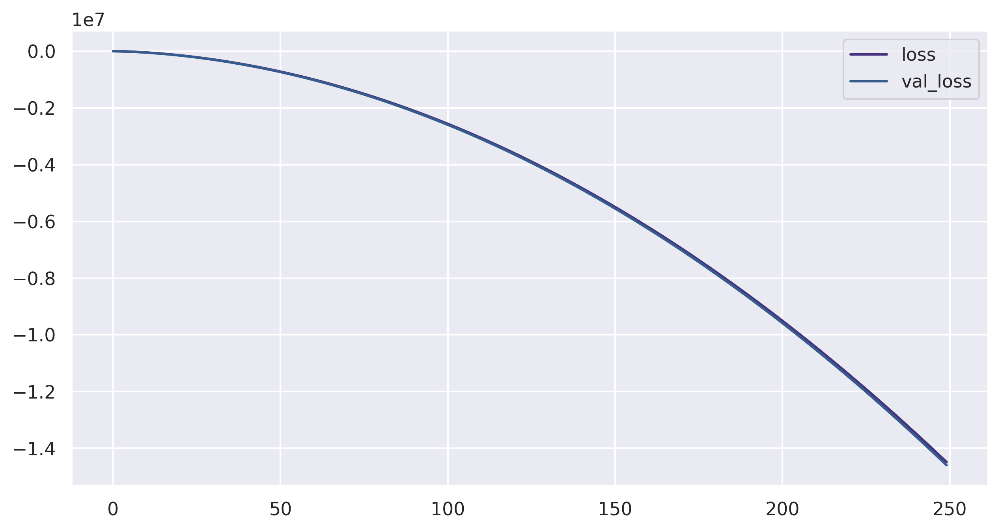

In [167]:
loss.plot()

In [168]:
#Initialize the ann
ann = Sequential()

#Create the Hidden Layer
ann.add(Dense(units=10,activation='relu'))

#Create the o/p Layer
ann.add(Dense(units=1,activation='sigmoid'))

#Establish the connection between all the layers
ann.compile(optimizer='adam',loss='binary_crossentropy')

#Train ANN
ann.fit(xtrain,ytrain,validation_data=(xtest,ytest),callbacks=[early],epochs=250)

Epoch 1/250
376/376 [==============================] - 2s 3ms/step - loss: -213.1131 - val_loss: -573.6963
Epoch 2/250
376/376 [==============================] - 1s 2ms/step - loss: -1217.5927 - val_loss: -2040.6241
Epoch 3/250
376/376 [==============================] - 1s 2ms/step - loss: -3075.9697 - val_loss: -4323.8545
Epoch 4/250
376/376 [==============================] - 1s 2ms/step - loss: -5696.6782 - val_loss: -7337.4204
Epoch 5/250
376/376 [==============================] - 1s 4ms/step - loss: -9000.7285 - val_loss: -11015.1592
Epoch 6/250
376/376 [==============================] - 1s 4ms/step - loss: -12934.0986 - val_loss: -15305.1328
Epoch 7/250
376/376 [==============================] - 1s 2ms/step - loss: -17444.4062 - val_loss: -20149.4238
Epoch 8/250
376/376 [==============================] - 1s 3ms/step - loss: -22496.5293 - val_loss: -25539.2812
Epoch 9/250
376/376 [==============================] - 1s 2ms/step - loss: -28045.3398 - val_loss: -31408.2285
Epoch 10/250

<Axes: >

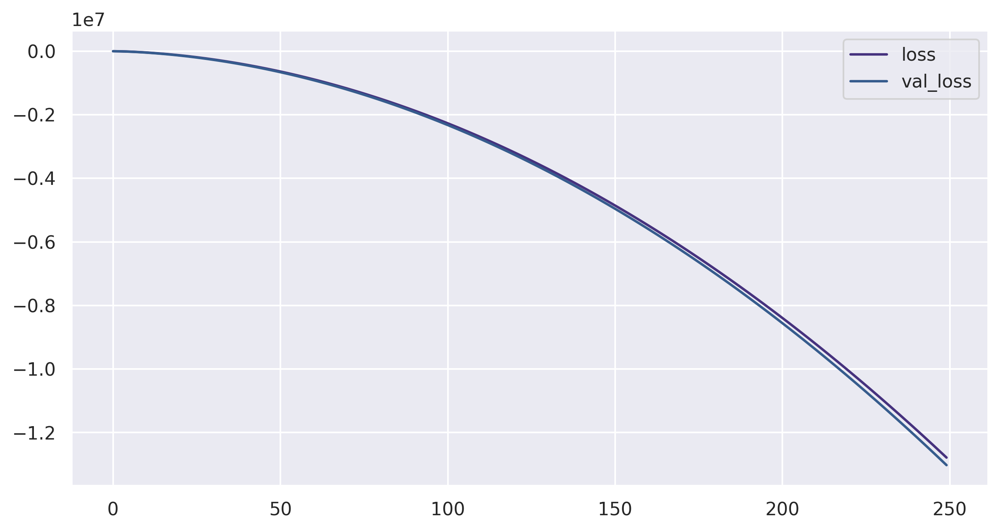

In [169]:
early_loss = pd.DataFrame(ann.history.history)
early_loss.plot()

In [170]:
#Visualizations

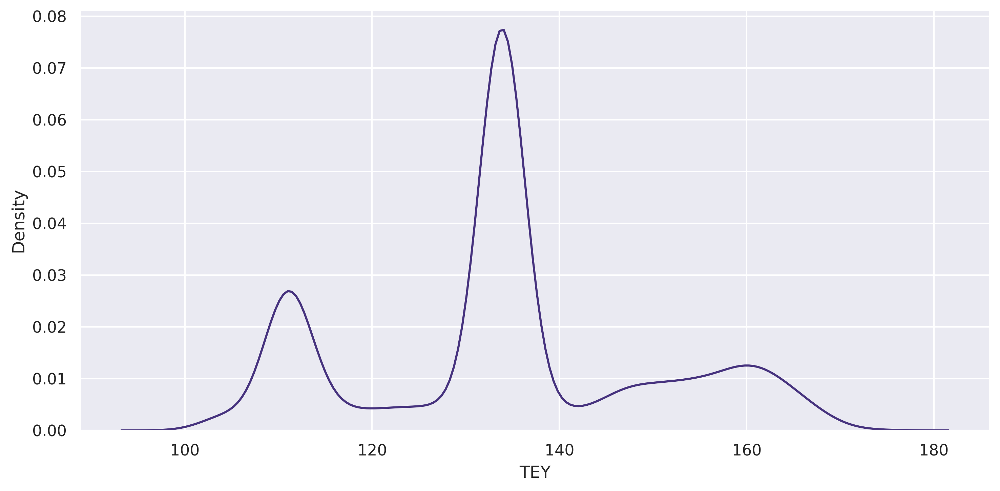

In [171]:
sns.kdeplot(df['TEY'])
plt.tight_layout()
plt.show()

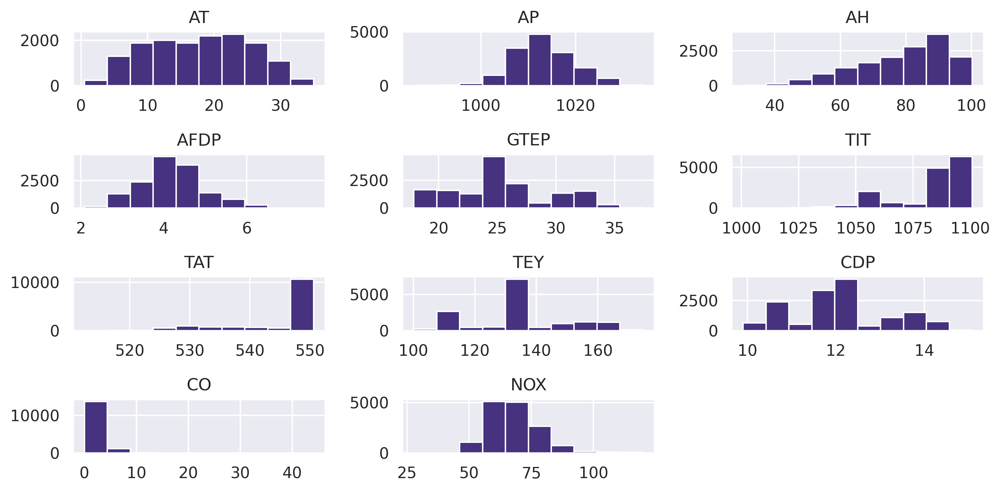

In [172]:
#Histogram and Densityplot
df.hist()
plt.tight_layout()
plt.show()

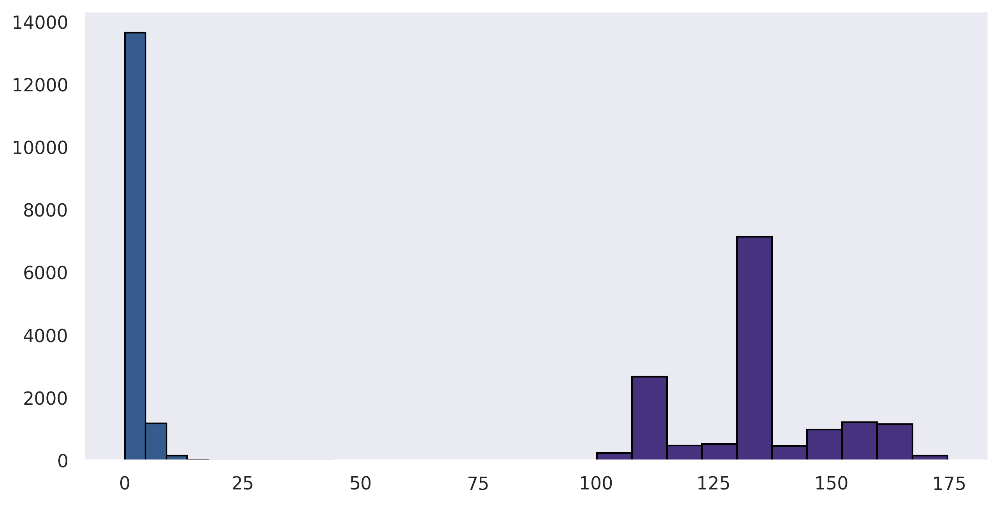

In [173]:
plt.hist(df['TEY'],edgecolor='black')
plt.hist(df['CO'],edgecolor='black')
plt.grid()

<Axes: >

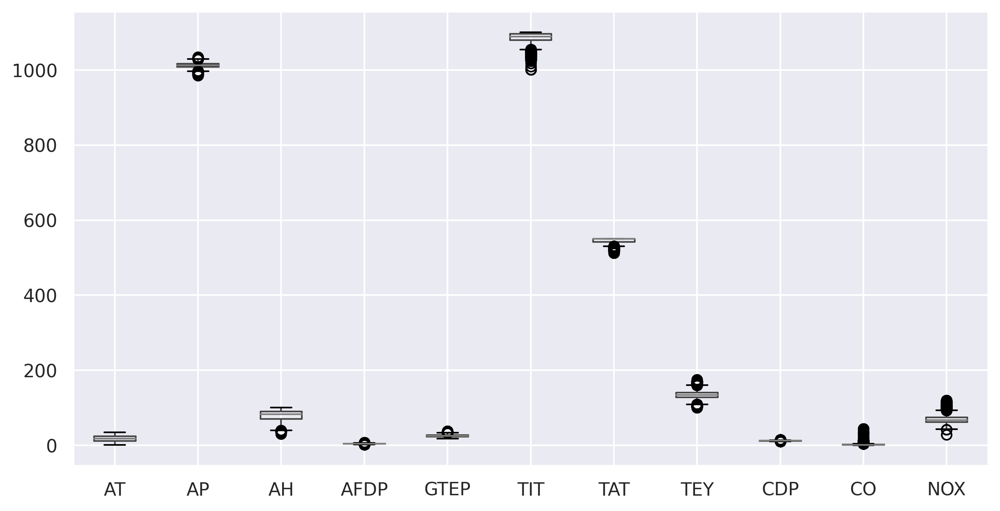

In [174]:
df.boxplot()

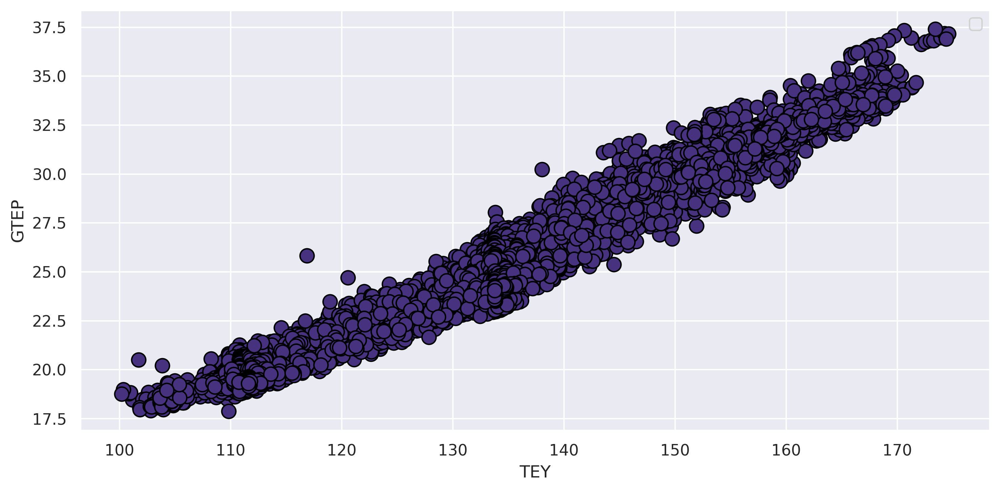

In [175]:
plt.scatter(df['TEY'],df['GTEP'],s=100,edgecolors='black')
plt.xlabel('TEY')
plt.ylabel('GTEP')
plt.tight_layout()
plt.legend()

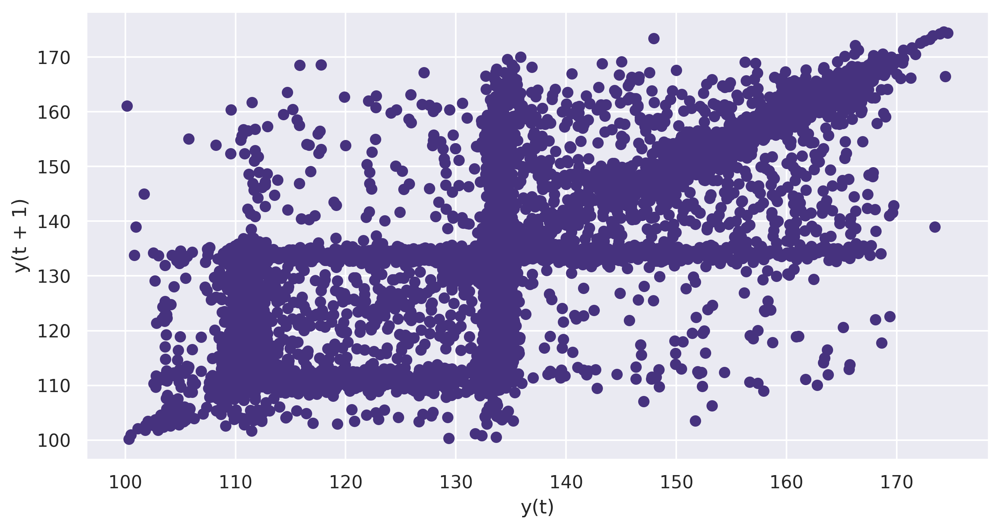

In [176]:
#Lag Plot
lag_plot(df['TEY'])
plt.show()

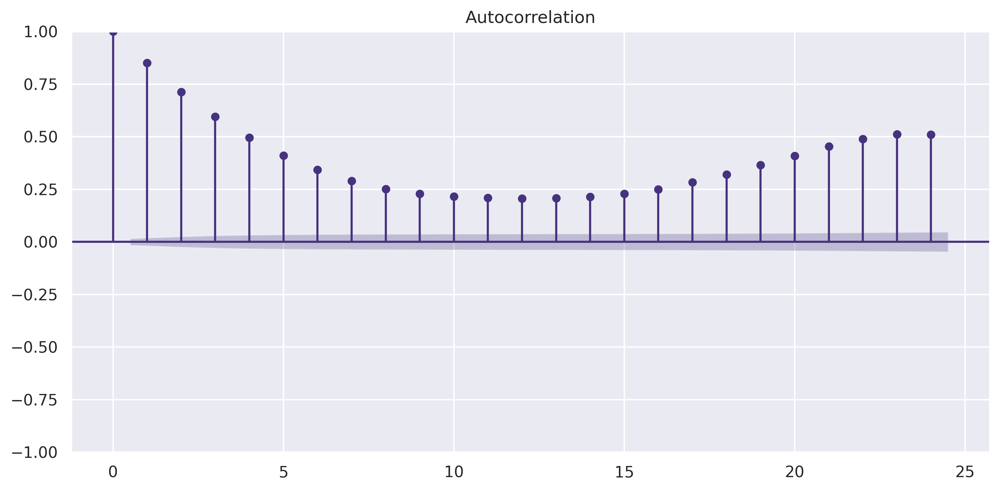

In [177]:
#Autocorrelation Plot
plot_acf(df['TEY'],lags=24)
plt.tight_layout()
plt.show()

In [178]:
sns.pairplot(df)
plt.tight_layout()
plt.show()